In [1]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import re
import cv2
from skimage.morphology import extrema
from skimage.morphology import watershed as skwater


# Image Segmentation

### Data processing

6 CSV files containing total of 5488 data in which the boundary coordinates of hemorrhages are labeled by the neurosurgeons, except multiple. Each CSV file is of one hemorrhage type The data that "Correct Label" and "Majority Label" are both empty were deleted. The “Correct Label” was chosen as the final label. If it does not exist, the ”Majority Label” was applied instead. Third, the boundaries of hemorrhage area are labeled independently. If there are multiple hemorrhage areas in one CT scan image, they are labelled separately. To get the overall hemorrhage area for each patient, I integrated these different pieces together into a single image.

In [2]:
epidu = pd.read_csv("E:\\Machine learning\\Hemorrhage Segmentation Project\\Results_Epidural Hemorrhage Detection_2020-11-16_21.31.26.148.csv")
Intra = pd.read_csv("E:\\Machine learning\\Hemorrhage Segmentation Project\\Results_Intraparenchymal Hemorrhage Detection_2020-11-16_21.39.31.268.csv")
Multiple = pd.read_csv("E:\\Machine learning\\Hemorrhage Segmentation Project\\Results_Multiple Hemorrhage Detection_2020-11-16_21.36.24.018.csv")
Subara = pd.read_csv("E:\\Machine learning\\Hemorrhage Segmentation Project\\Results_Subarachnoid Hemorrhage Detection_2020-11-16_21.36.18.668.csv")
Subdu1 = pd.read_csv("E:\\Machine learning\\Hemorrhage Segmentation Project\\Results_Subdural Hemorrhage Detection_2020-11-16_21.35.48.040.csv")
Subdu2 = pd.read_csv("E:\\Machine learning\\Hemorrhage Segmentation Project\\Results_Subdural Hemorrhage Detection_2020-11-16_21.37.19.745.csv")

In [3]:
epidu[['Origin','Majority Label','Correct Label']]

,Origin,Majority Label,Correct Label
0,ID_004c4b319.jpg,"[{""x"": 0.537109375, ""y"": 0.89453125}, {""x"": 0....","[[{'x': 0.537109375, 'y': 0.89453125}, {'x': 0..."
1,ID_0237b835f.jpg,"[{""x"": 0.654296875, ""y"": 0.724609375}, {""x"": 0...",NaN
2,ID_02e2d273d.jpg,"[{""x"": 0.46484375, ""y"": 0.357421875}, {""x"": 0....","[[{'x': 0.46484375, 'y': 0.357421875}, {'x': 0..."
3,ID_02f37ce84.jpg,"[{""x"": 0.431640625, ""y"": 0.607421875}, {""x"": 0...",NaN
4,ID_02f37ce84.jpg,"[{""x"": 0.353515625, ""y"": 0.59765625}, {""x"": 0....",NaN
...,...,...,...
605,ID_879afbc77.jpg,[],NaN
606,ID_af76460ee.jpg,[],NaN
607,ID_d6d369eaa.jpg,[],NaN
608,ID_d9bfa60ed.jpg,[],"[[{'x': 0.443359375, 'y': 0.810546875}, {'x': ..."


#### Combine the 6 csv files into 1

In [4]:
ALL=pd.concat([epidu,Intra,Multiple,Subara,Subdu1,Subdu2])

In [5]:
# Remove rows without labeling information
wrong_w=['[]','[[],[]]','[[]]','[[], []]']
for i in wrong_w:
    ALL=ALL.replace(to_replace= i, value=np.nan)

row_indexs=ALL[(ALL['Correct Label'].isnull())&(ALL['Majority Label'].isnull())].index
All=ALL.drop(row_indexs)

ind= All.index.to_list()
ind1=All[All['Correct Label'].isnull()]['Majority Label'].index.tolist()

All['Final Label']=''
for i in ind:
    if i in ind1:
        All['Final Label'][i]= All['Majority Label'][i]
    else:
        All['Final Label'][i]= All['Correct Label'][i]

C:\Users\admin\AppData\Local\Temp/ipykernel_18148/3752941021.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  All['Final Label']=''
C:\Users\admin\AppData\Local\Temp/ipykernel_18148/3752941021.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  All['Final Label'][i]= All['Majority Label'][i]
C:\Users\admin\AppData\Local\Temp/ipykernel_18148/3752941021.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

In [6]:
All['Final Label']

0      [{"x": 0.537109375, "y": 0.89453125}, {"x": 0....
1      [{"x": 0.654296875, "y": 0.724609375}, {"x": 0...
2      [{"x": 0.46484375, "y": 0.357421875}, {"x": 0....
3      [{"x": 0.431640625, "y": 0.607421875}, {"x": 0...
4      [{"x": 0.353515625, "y": 0.59765625}, {"x": 0....
                             ...                        
738    [[{'x': 0.685546875, 'y': 0.43359375}, {'x': 0...
739    [{"x": 0.630859375, "y": 0.24609375}, {"x": 0....
740    [{"x": 0.70703125, "y": 0.67578125}, {"x": 0.7...
741                                                  NaN
743                                                  NaN
Name: Final Label, Length: 5251, dtype: object

In [7]:
row_indexs1=All[(All['Final Label'].isnull())].index
AL=All.drop(row_indexs1)
AL

,Case ID,Origin,URL,Labeling State,All Labels,Total Reads,Total Qualified Reads,Majority Label,Number of ROIs,Correct Label,Difficulty,Agreement,Comments,Internal Notes,Final Label
0,1196514,ID_004c4b319.jpg,https://go.centaurlabs.com/problem/1196514,Labeled,"['[{""x"": 0.40818718, ""y"": 0.8623607}, {""x"": 0....",19.0,5.0,"[{""x"": 0.537109375, ""y"": 0.89453125}, {""x"": 0....",1.0,"[[{'x': 0.537109375, 'y': 0.89453125}, {'x': 0...",0.00,0.968851,NaN,NaN,"[{""x"": 0.537109375, ""y"": 0.89453125}, {""x"": 0...."
1,1196682,ID_0237b835f.jpg,https://go.centaurlabs.com/problem/1196682,Ready,"['[{""x"": 0.62959146, ""y"": 0.720186}, {""x"": 0.6...",51.0,28.0,"[{""x"": 0.654296875, ""y"": 0.724609375}, {""x"": 0...",1.0,NaN,NaN,0.063519,NaN,NaN,"[{""x"": 0.654296875, ""y"": 0.724609375}, {""x"": 0..."
2,1196477,ID_02e2d273d.jpg,https://go.centaurlabs.com/problem/1196477,Labeled,"['[{""x"": 0.35205495, ""y"": 0.34680602}, {""x"": 0...",22.0,6.0,"[{""x"": 0.46484375, ""y"": 0.357421875}, {""x"": 0....",1.0,"[[{'x': 0.46484375, 'y': 0.357421875}, {'x': 0...",0.06,0.710300,NaN,NaN,"[{""x"": 0.46484375, ""y"": 0.357421875}, {""x"": 0...."
3,1196612,ID_02f37ce84.jpg,https://go.centaurlabs.com/problem/1196612,Ready,"['[{""x"": 0.3680166, ""y"": 0.48387372}, {""x"": 0....",51.0,29.0,"[{""x"": 0.431640625, ""y"": 0.607421875}, {""x"": 0...",2.0,NaN,NaN,0.264134,NaN,NaN,"[{""x"": 0.431640625, ""y"": 0.607421875}, {""x"": 0..."
4,1196612,ID_02f37ce84.jpg,https://go.centaurlabs.com/problem/1196612,Ready,"['[{""x"": 0.3680166, ""y"": 0.48387372}, {""x"": 0....",51.0,29.0,"[{""x"": 0.353515625, ""y"": 0.59765625}, {""x"": 0....",2.0,NaN,NaN,0.264134,NaN,NaN,"[{""x"": 0.353515625, ""y"": 0.59765625}, {""x"": 0...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
736,1198300,ID_fef30f0b4.jpg,https://go.centaurlabs.com/problem/1198300,Labeled,"['[{""x"": 0.5635891, ""y"": 0.6987898}, {""x"": 0.5...",11.0,5.0,"[{""x"": 0.62890625, ""y"": 0.861328125}, {""x"": 0....",1.0,"[[{'x': 0.630859375, 'y': 0.85546875}, {'x': 0...",0.04,0.724464,NaN,NaN,"[{""x"": 0.62890625, ""y"": 0.861328125}, {""x"": 0...."
737,1198392,ID_ff1e93267.jpg,https://go.centaurlabs.com/problem/1198392,Labeled,"['[{""x"": 0.25159726, ""y"": 0.24648584}, {""x"": 0...",19.0,5.0,"[{""x"": 0.474609375, ""y"": 0.8046875}, {""x"": 0.4...",3.0,"[[{'x': 0.685546875, 'y': 0.43359375}, {'x': 0...",0.48,0.607623,NaN,NaN,"[{""x"": 0.474609375, ""y"": 0.8046875}, {""x"": 0.4..."
738,1198392,ID_ff1e93267.jpg,https://go.centaurlabs.com/problem/1198392,Labeled,"['[{""x"": 0.25159726, ""y"": 0.24648584}, {""x"": 0...",19.0,5.0,"[{""x"": 0.68359375, ""y"": 0.42578125}, {""x"": 0.6...",3.0,"[[{'x': 0.685546875, 'y': 0.43359375}, {'x': 0...",0.48,0.607623,NaN,NaN,"[[{'x': 0.685546875, 'y': 0.43359375}, {'x': 0..."
739,1198392,ID_ff1e93267.jpg,https://go.centaurlabs.com/problem/1198392,Labeled,"['[{""x"": 0.25159726, ""y"": 0.24648584}, {""x"": 0...",19.0,5.0,"[{""x"": 0.630859375, ""y"": 0.24609375}, {""x"": 0....",3.0,"[[{'x': 0.685546875, 'y': 0.43359375}, {'x': 0...",0.48,0.607623,NaN,NaN,"[{""x"": 0.630859375, ""y"": 0.24609375}, {""x"": 0...."


In [8]:
df_merge = AL.groupby(AL['Origin']).agg(Label=("Final Label", lambda x : ";".join(x.unique())))
df= pd.DataFrame(df_merge)
name=df_merge.index
name_ls=name.to_list()
df

,Label
Origin,
ID_0002081b6.jpg,"[{""x"": 0.3046875, ""y"": 0.484375}, {""x"": 0.3046..."
ID_001b1b944.jpg,"[{""x"": 0.314453125, ""y"": 0.75}, {""x"": 0.314453..."
ID_0048e60a4.jpg,"[{""x"": 0.5859375, ""y"": 0.640625}, {""x"": 0.5859..."
ID_004c4b319.jpg,"[{""x"": 0.537109375, ""y"": 0.89453125}, {""x"": 0...."
ID_0057d2736.jpg,"[{""x"": 0.3046875, ""y"": 0.521484375}, {""x"": 0.3..."
...,...
ID_ffb8b3408.jpg,"[{""x"": 0.44921875, ""y"": 0.748046875}, {""x"": 0...."
ID_ffc54be74.jpg,"[[{'x': 0.287109375, 'y': 0.443359375}, {'x': ..."
ID_ffd581895.jpg,"[[{'x': 0.3671875, 'y': 0.666015625}, {'x': 0...."


### Mask hemorrhage area

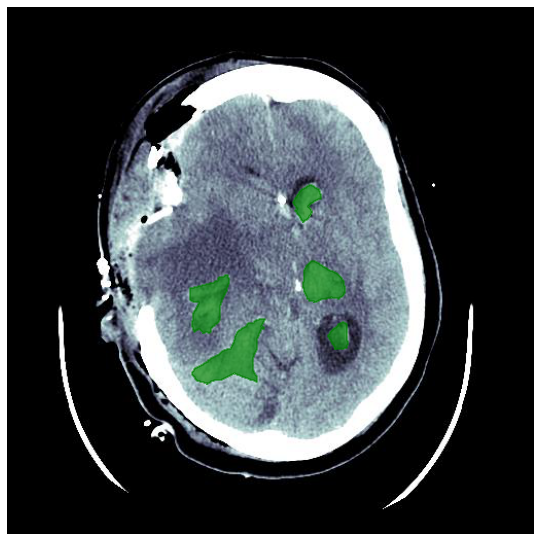

In [9]:
#plot boundary sample
al = df.iloc[1000]
a=re.split(r'(?:[;])', al['Label'])
b=len(a)

for u in range(b):
       try:
        S_label = eval(a[u]) 
        image_sample = matplotlib.image.imread("E:\\Machine learning\\brain_window\\"+str(name3[1000]))

        plt.imshow(image_sample)
        
        x = [valx['x'] for valx in S_label]
        y = [valy['y'] for valy in S_label]
        X = [x * 512 for x in x]
        Y = [y * 512 for y in y]
        plt.plot(X, Y, color="green",alpha=0.7)
        plt.fill(X, Y,'green',alpha=0.7)

        except TypeError:
            pass  
        continue
    
plt.axis('off')
plt.gcf().set_size_inches(512 / 70 , 512 / 70 )
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
Name=str(name3[2])
#plt.savefig('E:\\Machine learning\\bw\\squares1.png', pad_inches = 1,transparent = True,facecolor ='g',orientation ='landscape')
plt.savefig("E:\\Machine learning\\"+str(name3[2]))
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


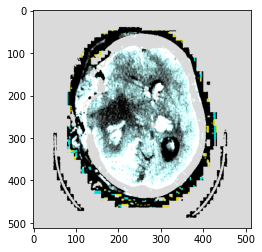

In [10]:
from skimage import morphology
image_sample = matplotlib.image.imread("E:\\Machine learning\\brain_window\\"+str(name3[1000]))
row = image_sample.shape[0]
col = image_sample.shape[1]
mean = np.mean(image_sample)
std = np.std(image_sample)
img1 = image_sample - mean
img2 = img1/std
mid = img2[int(col / 5):int(col / 5 * 4), int(row/ 5):int(row / 5 * 4)]
mean = np.mean(mid)
max = np.max(img2)
min = np.min(img2)
img2[img2 == max] = mean
img2[img2 == min] = mean
ero = morphology.erosion(img2, np.ones([3, 3, 3]))
dil = morphology.dilation(ero, np.ones([3, 3, 3]))
plt.imshow(dil)

In [10]:

def ShowImage(title,img,ctype):
    plt.figure(figsize=(10, 10))
    if ctype=='bgr':
        b,g,r = cv2.split(img)       # get b,g,r
        rgb_img = cv2.merge([r,g,b])     # switch it to rgb
        plt.imshow(rgb_img)
    elif ctype=='hsv':
        rgb = cv2.cvtColor(img,cv2.COLOR_HSV2RGB)
        plt.imshow(rgb)
    elif ctype=='gray':
        plt.imshow(img,cmap='gray')
    elif ctype=='rgb':
        plt.imshow(img)
    else:
        raise Exception("Unknown colour type")
    plt.axis('off')
    plt.title(title)
    plt.show()

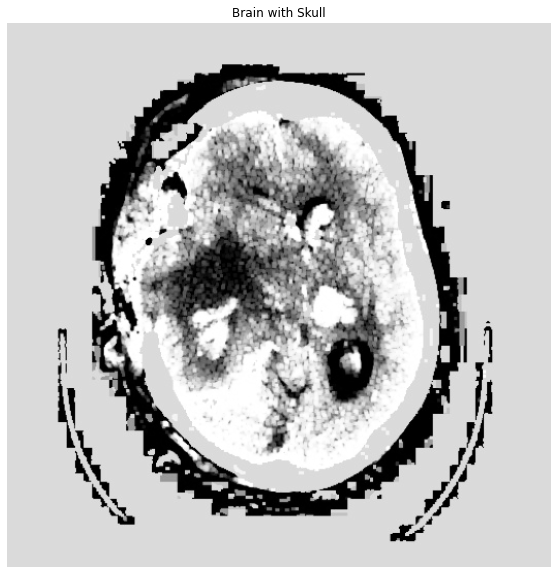

In [11]:
img           = cv2.imread("E:\\Machine learning\\brain\\"+str(name3[1000]))
gray          = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
#gray          = cv2.cvtColor(img,cv2.COLOR_BGR2HLS)
ShowImage('Brain with Skull',gray,'gray')

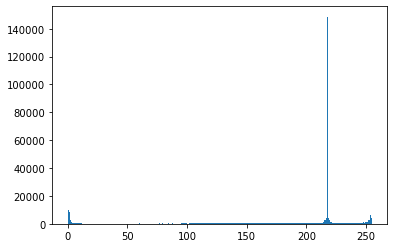

In [12]:
#Make a histogram of the intensities in the grayscale image
plt.hist(gray.ravel(),256)
plt.show()

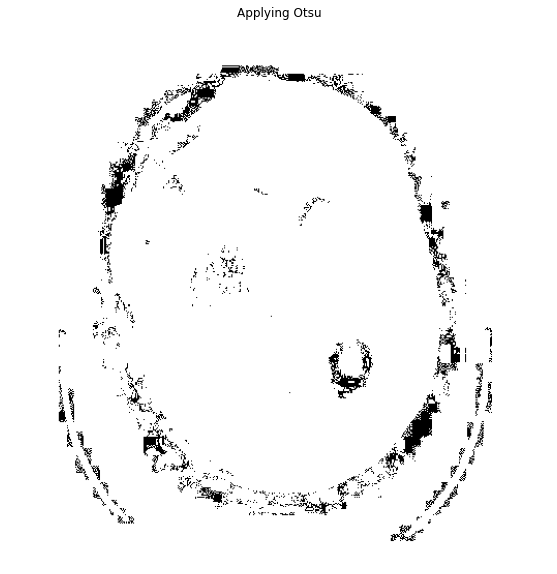

In [16]:
#Threshold the image to binary using Otsu's method
ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY)
ShowImage('Applying Otsu',thresh,'gray')

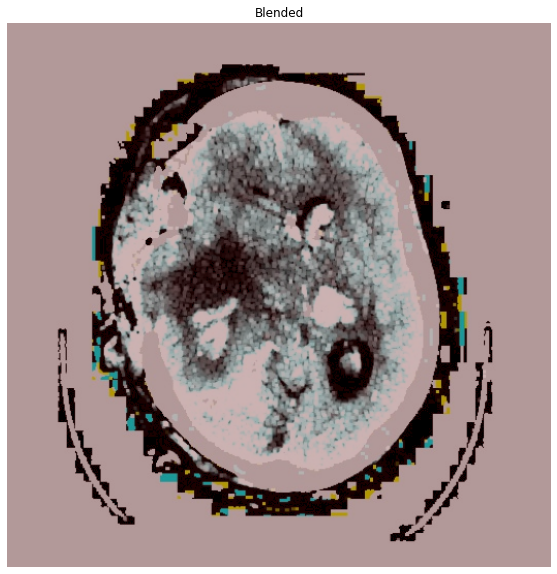

In [17]:
colormask = np.zeros(img.shape, dtype=np.uint8)
colormask[thresh!=0] = np.array((0,0,255))
blended = cv2.addWeighted(img,0.7,colormask,0.1,0)
ShowImage('Blended', blended, 'bgr')

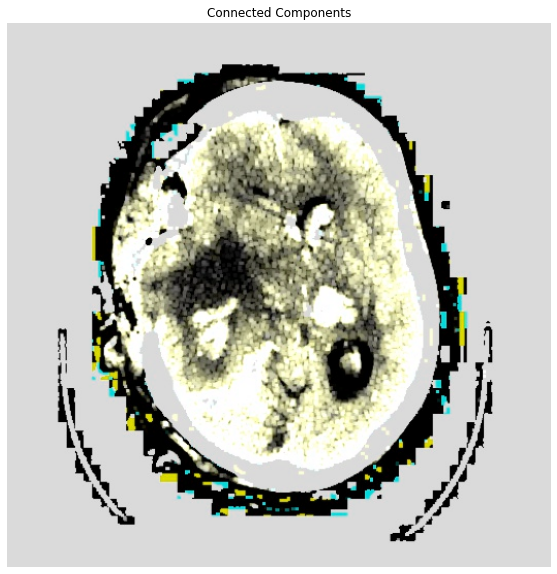

In [18]:
ret, markers = cv2.connectedComponents(thresh)

#Get the area taken by each component. Ignore label 0 since this is the background.
marker_area = [np.sum(markers==m) for m in range(np.max(markers)) if m!=0] 
#Get label of largest component by area
largest_component = np.argmax(marker_area)+1 #Add 1 since we dropped zero above                        
#Get pixels which correspond to the brain
brain_mask = markers==largest_component

brain_out = img.copy()
#In a copy of the original image, clear those pixels that don't correspond to the brain
brain_out[brain_mask==False] = (0,0,0)
ShowImage('Connected Components',brain_out,'gray')

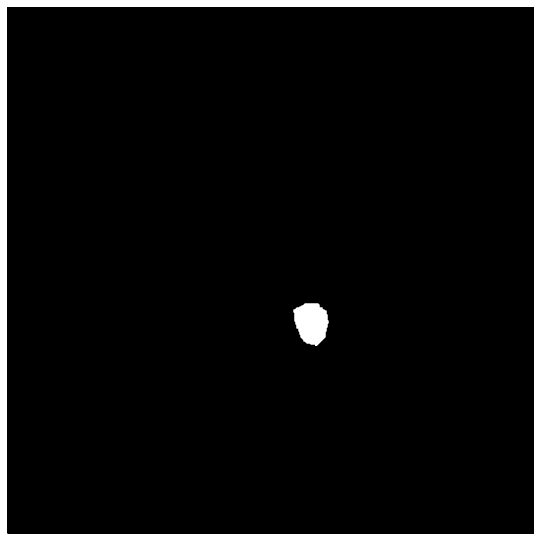

In [10]:
#mask sample
al = df.iloc[2]
a=re.split(r'(?:[;])', al['Label'])
b=len(a)

for u in range(b):
       try:
        S_label = eval(a[u]) 
        image_sample = matplotlib.image.imread("E:\\Machine learning\\brain_window\\"+str(name3[2]))
        plt.imshow(image_sample)
        X0 = [0,512,512,0]
        Y0 = [0,0,512,512]
        plt.plot(X0, Y0, color="Black")
        plt.fill(X0, Y0,'black',alpha=1)
        
        x = [valx['x'] for valx in S_label]
        y = [valy['y'] for valy in S_label]
        X = [x * 512 for x in x]
        Y = [y * 512 for y in y]
        plt.plot(X, Y, color="white")
        plt.fill(X, Y,'white',alpha=1)

        except TypeError:
            pass
        continue
    
plt.axis('off')
plt.gcf().set_size_inches(512 / 70 , 512 / 70 )
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
Name=str(name3[2])
#plt.savefig('E:\\Machine learning\\bw\\squares1.png', pad_inches = 1,transparent = True,facecolor ='g',orientation ='landscape')
plt.savefig("E:\\Machine learning\\"+Name[0:-4]+".png")
plt.show()

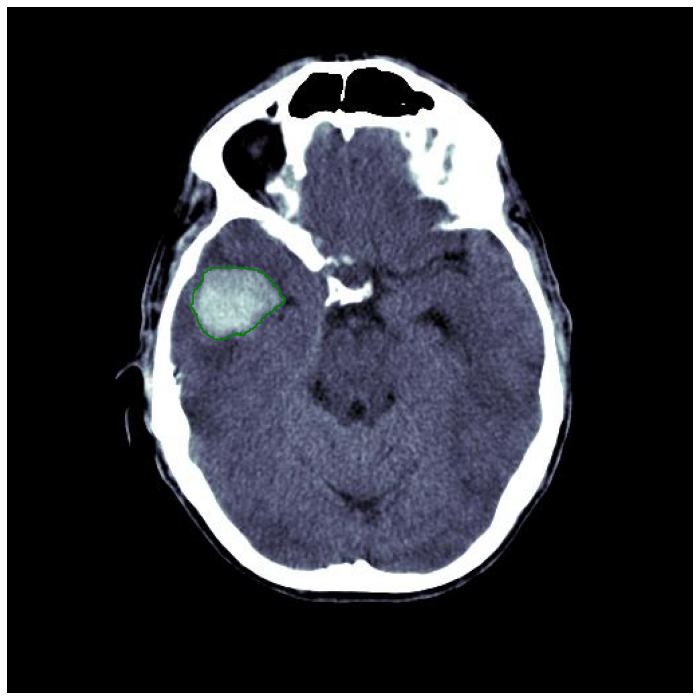

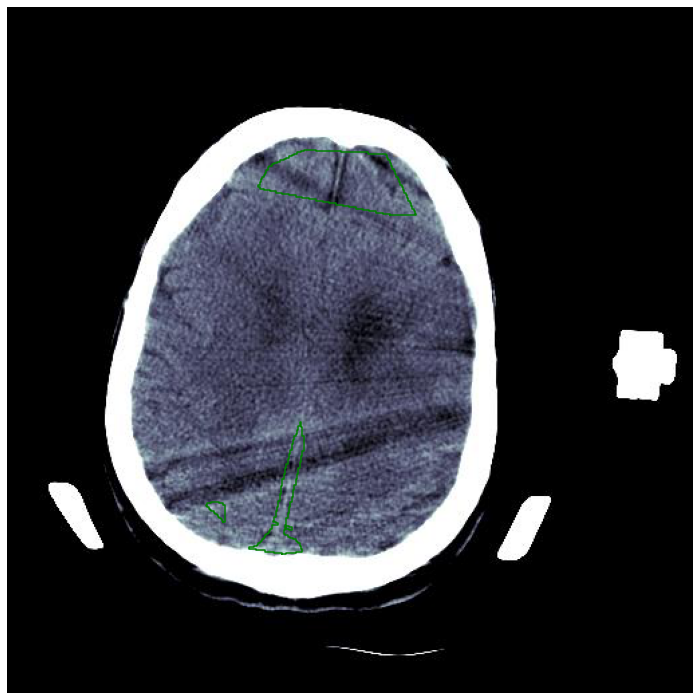

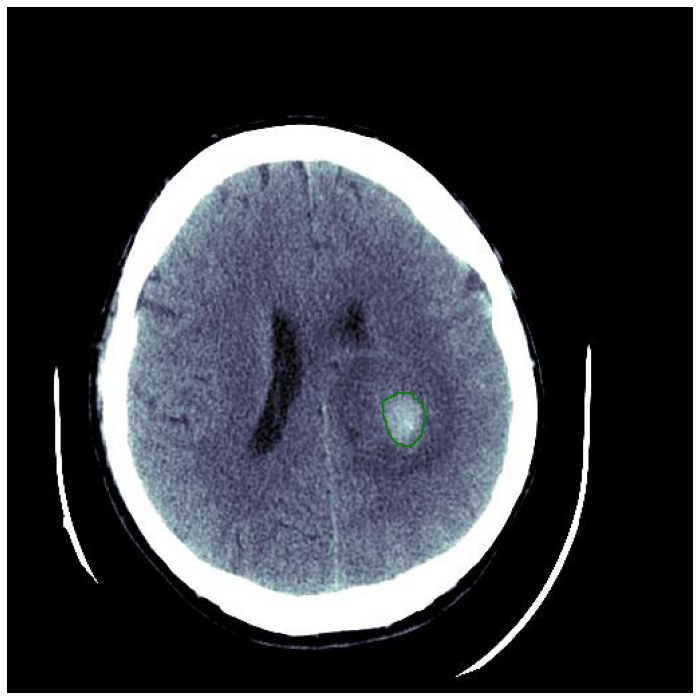

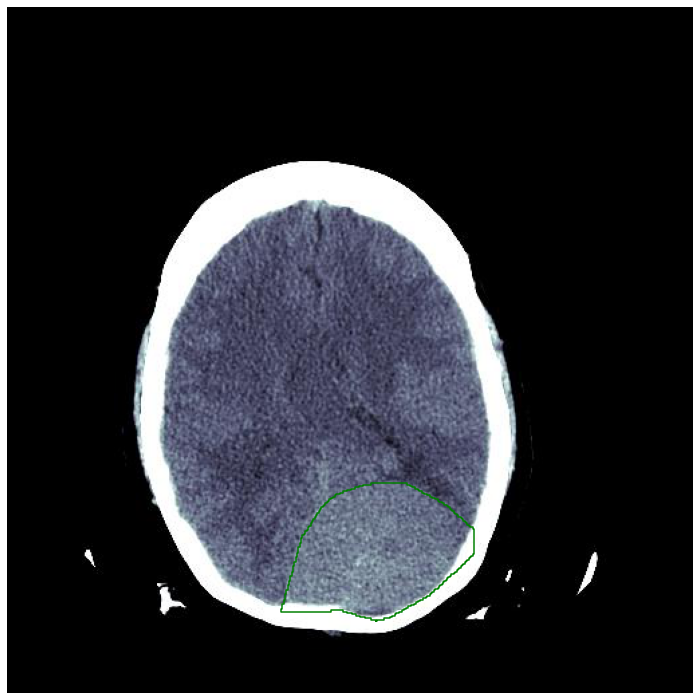

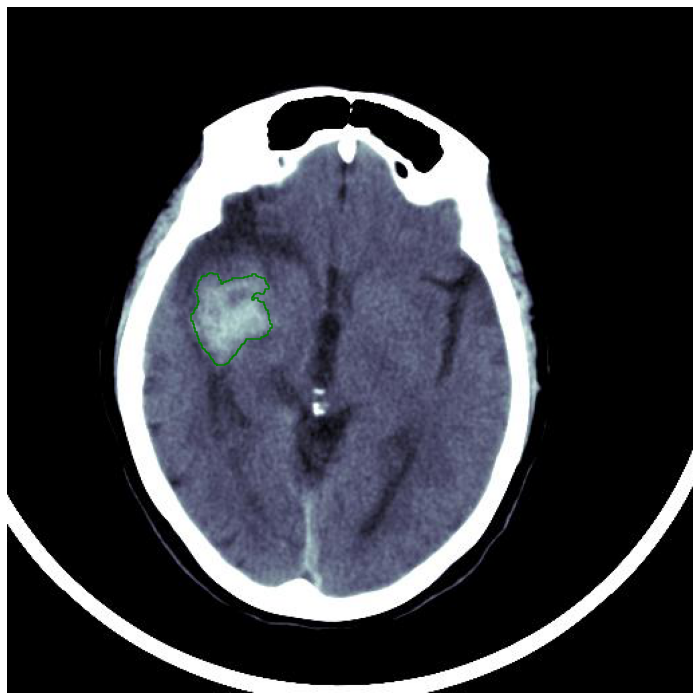

...

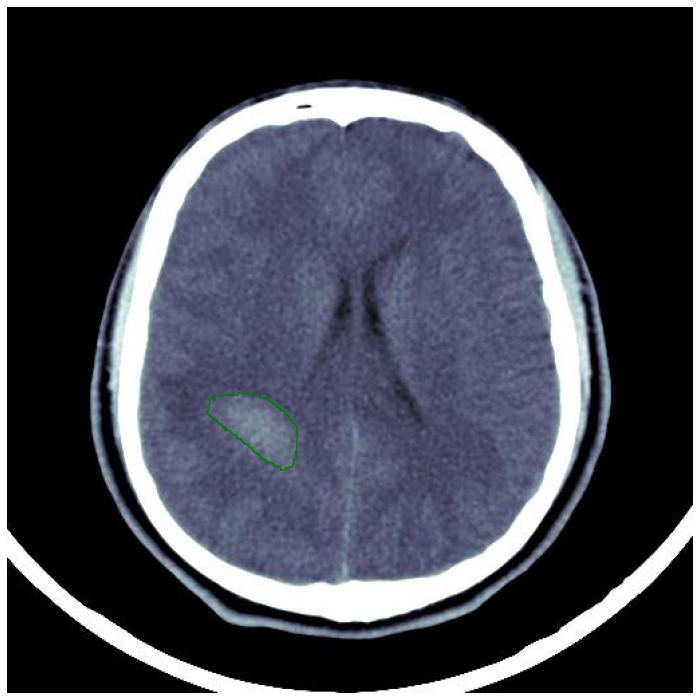

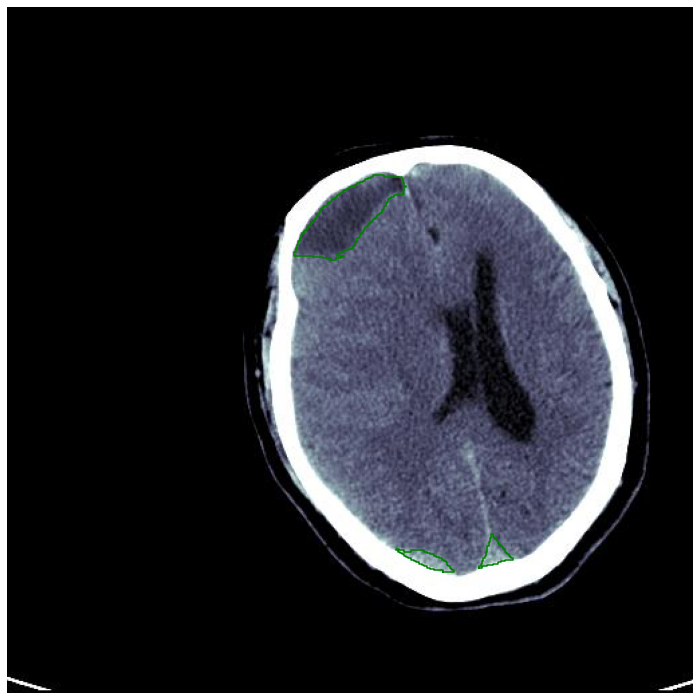

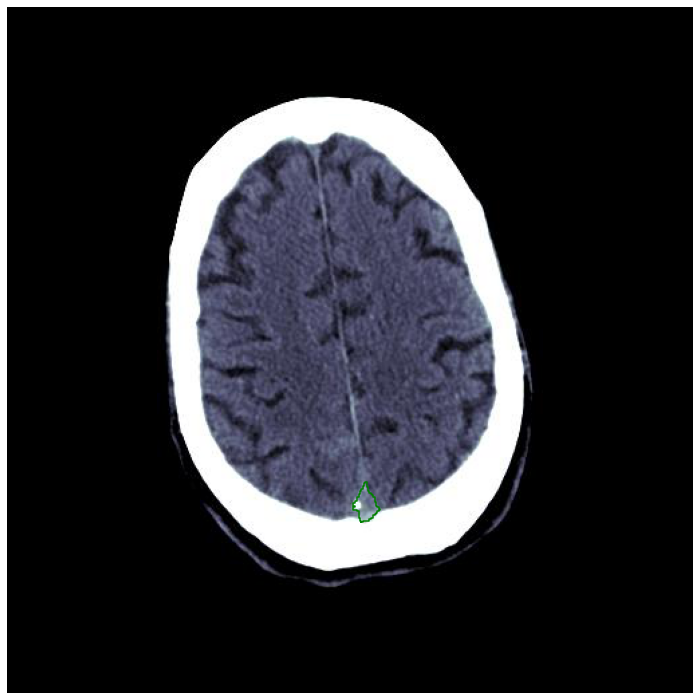

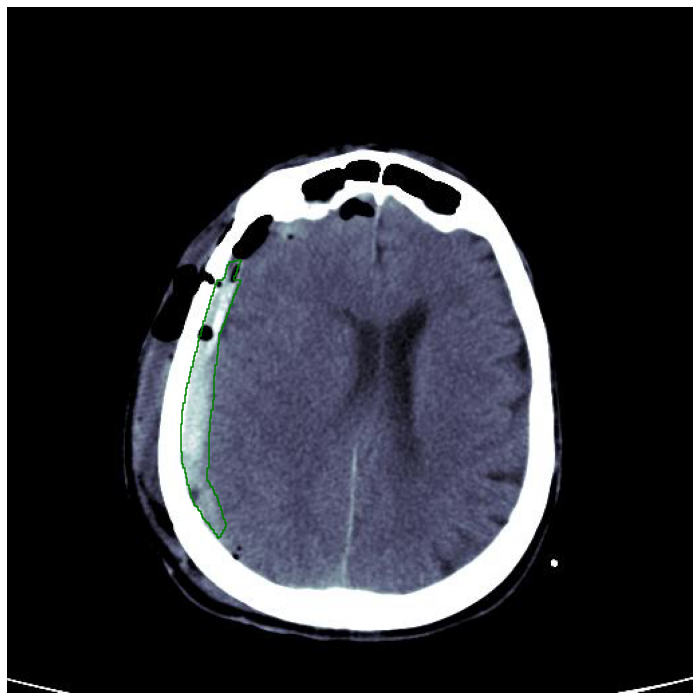

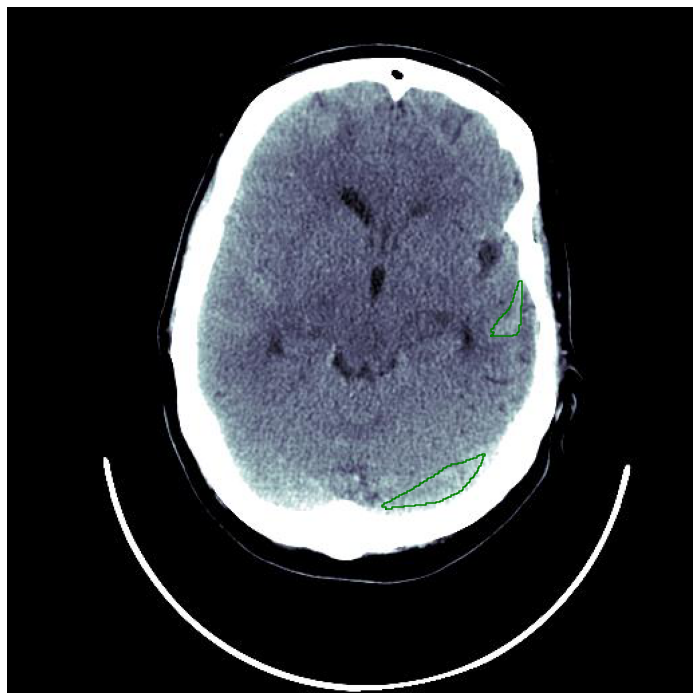

TypeError: list indices must be integers or slices, not str

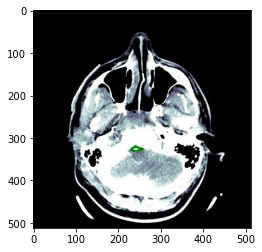

In [127]:
#plot all boundary
for i in range(len(df)):
    al = df.iloc[i]
    a=re.split(r'(?:[;])', al['Label'])
    b=len(a)
    wrong_list=[]
    try:
    for u in range(b):
       
        S_label = eval(a[u])
        x = [valx['x'] for valx in S_label]
        y = [valy['y'] for valy in S_label]
        X = [x * 512 for x in x]
        Y = [y * 512 for y in y]
        image_sample = matplotlib.image.imread("E:\\Machine learning\\brain_window\\"+str(name3[i]))
        plt.imshow(image_sample)
        plt.plot(X, Y, color="green",alpha=0.7)
        plt.fill(X, Y,'g',alpha=0.7)

    plt.axis('off')
    plt.gcf().set_size_inches(512 / 70 , 512 / 70 )
    plt.gca().xaxis.set_major_locator(plt.NullLocator())
    plt.gca().yaxis.set_major_locator(plt.NullLocator())
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    plt.margins(0, 0)
    plt.savefig("E:\\Machine learning\\brain_boundary\\"+str(name3[i]))
    plt.show()
    except TypeError:
           pass
           wrong_list.append(name3[i])
    continue

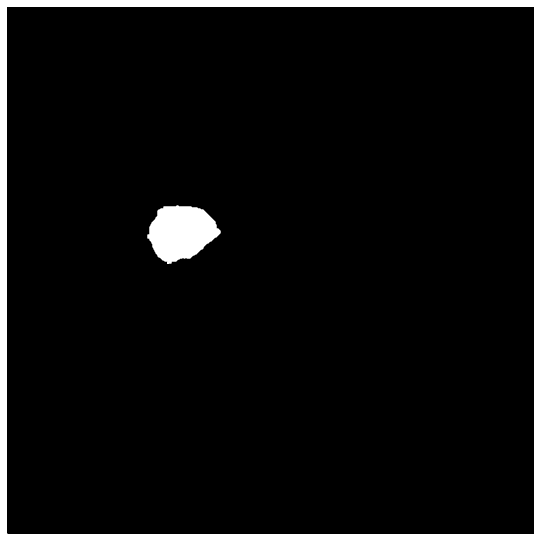

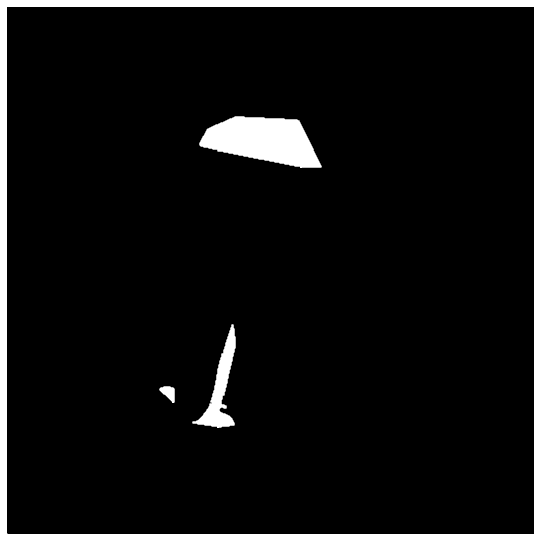

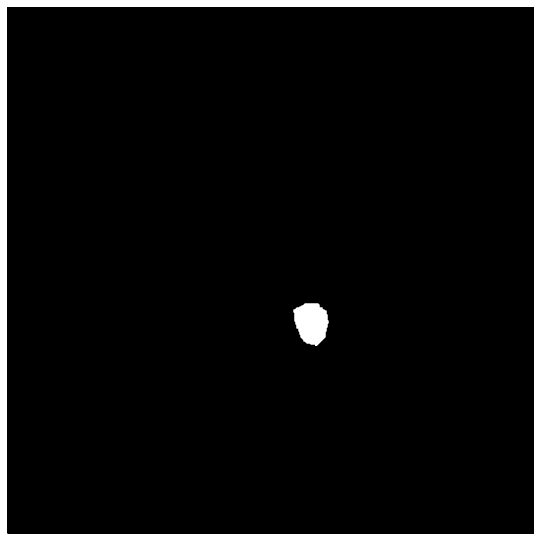

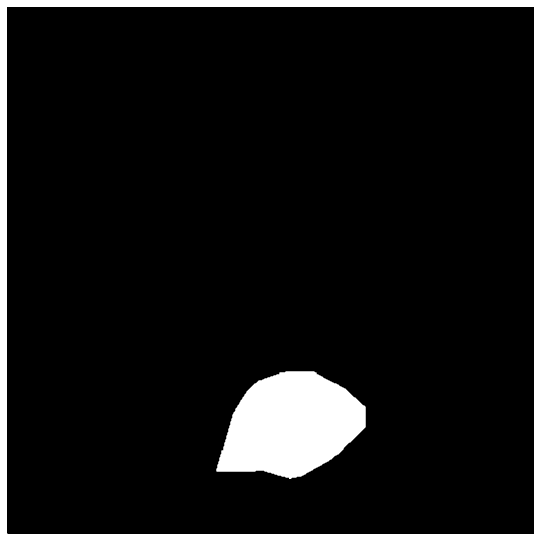

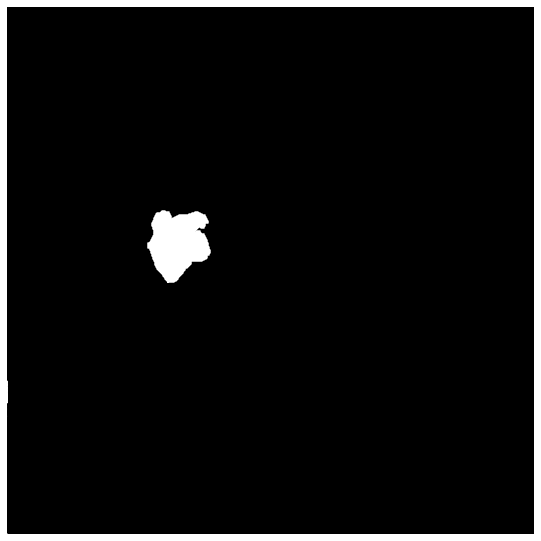

...

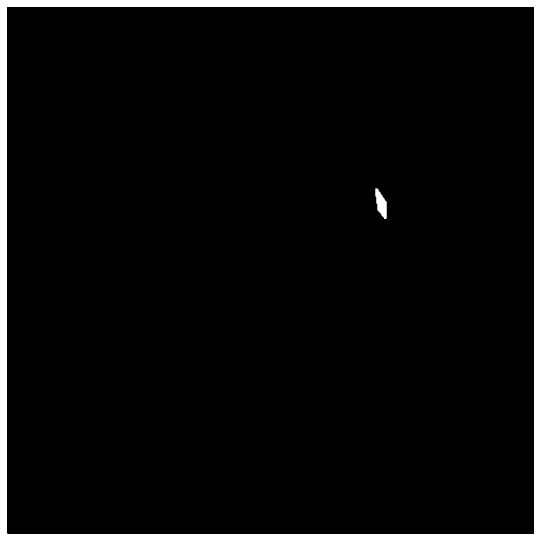

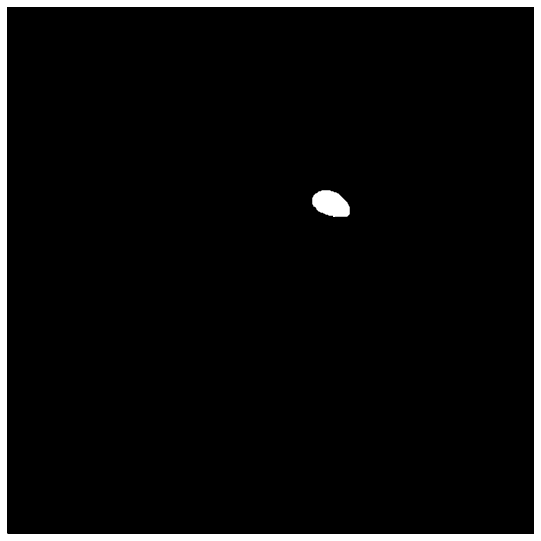

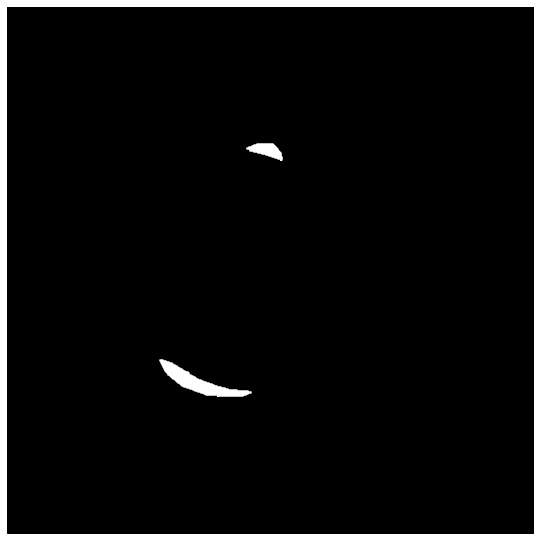

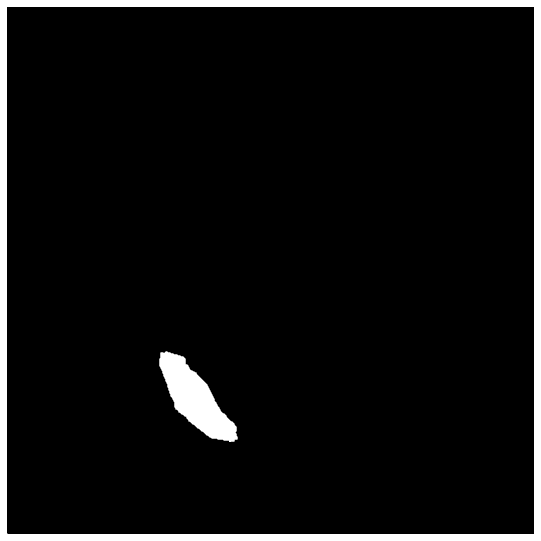

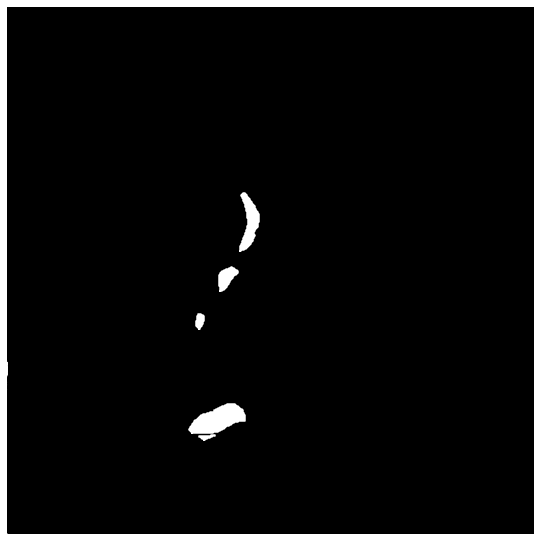

In [9]:
#all mask
for i in range(len(df)):
    al = df.iloc[i]
    a=re.split(r'(?:[;])', al['Label'])
    b=len(a)
    wrong_list=[]
    try:
        image_sample = matplotlib.image.imread("E:\\Machine learning\\brain_window\\"+str(name3[i]))
        plt.imshow(image_sample)
        X0 = [0,512,512,0]
        Y0 = [0,0,512,512]
        plt.plot(X0, Y0, color="Black")
        plt.fill(X0, Y0,'black',alpha=1)

        for u in range(b):

        S_label = eval(a[u]) 
        x = [valx['x'] for valx in S_label]
        y = [valy['y'] for valy in S_label]
        X = [x * 512 for x in x]
        Y = [y * 512 for y in y]
        plt.plot(X, Y, color="white")
        plt.fill(X, Y,'white',alpha=1)

        plt.axis('off')
        plt.gcf().set_size_inches(512 / 70 , 512 / 70 )
        plt.gca().xaxis.set_major_locator(plt.NullLocator())
        plt.gca().yaxis.set_major_locator(plt.NullLocator())
        plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
        plt.margins(0, 0)

        Name=str(name3[i])
        plt.savefig("E:\\Machine learning\\brain_mask\\"+Name[0:-4]+'.png')
        plt.show()
    except TypeError:
          pass
          wrong_list.append(name3[i])
    continue


In [ ]:
#Origin
for i in range(2000,len(df)):
    img = matplotlib.image.imread("E:\\Machine learning\\brain_window\\"+str(name6[i]))
    row_size = img.shape[0]
    col_size = img.shape[1]
    mean = np.mean(img)
    std = np.std(img)
    img = img - mean
    img = img / std
    middle = img[int(col_size / 5):int(col_size / 5 * 4), int(row_size / 5):int(row_size / 5 * 4)]
    mean = np.mean(middle)
    max = np.max(img)
    min = np.min(img)
    img[img == max] = mean
    img[img == min] = mean
    eroded = morphology.erosion(img, np.ones([3, 3, 3]))
    dilation = morphology.dilation(eroded, np.ones([3, 3, 3]))
    plt.imshow(dilation)
    plt.axis('off')
    plt.gcf().set_size_inches(512 / 70 , 512 / 70 )
    plt.gca().xaxis.set_major_locator(plt.NullLocator())
    plt.gca().yaxis.set_major_locator(plt.NullLocator())
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    plt.margins(0, 0)
    plt.savefig("E:\\Machine learning\\brain\\"+str(name6[i]))
    #plt.show()




In [11]:
filePath = 'E:\\Machine learning\\brain_mask\\'
filePath1 = 'E:\\Machine learning\\brain_boundary\\'
name5 = os.listdir(filePath)
name6 = os.listdir(filePath1)
print(len(name5))
print(len(name6))

2526
2526


In [2]:
set(name5).intersection(set(name6))

{'ID_0048e60a4.png'}